In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
path_all = '/content/gdrive/MyDrive/archeology_AI/三星堆遗址'

pic = '/*/*/*.JPG'
desc = '/三星堆遗址拍摄记录 - 副本.xlsx'
saved_feat = '/content/gdrive/MyDrive/archeology_AI/Analysis/unsupervised_learning/feat_vgg16/'

path_pic = path_all + pic
path_desc = path_all + desc
path_feat = path_all + saved_feat

In [ ]:
# /content/gdrive/MyDrive/archeology_AI/Analysis/1. unsupervised learning/feat_vgg16

'/content/gdrive/MyDrive/archeology_AI/三星堆遗址/三星堆遗址拍摄记录 - 副本.xlsx'

/content/gdrive/MyDrive/archeology_AI/三星堆遗址/86GSⅢT1415:
86GSⅢT1415⑪  86GSⅢT1415⑤  86GSⅢT1415⑨  86GSⅢT1415⑧A  86GSⅢT1415⑧B  86GSⅢT1415⑧C

/content/gdrive/MyDrive/archeology_AI/三星堆遗址/86GSⅢT1416:
86GSⅢT1416⑦  86GSⅢT1416⑤  86GSⅢT1416⑥  86GSⅢT1416⑧A  86GSⅢT1416⑧B

/content/gdrive/MyDrive/archeology_AI/三星堆遗址/86GSⅢT1516:

/content/gdrive/MyDrive/archeology_AI/三星堆遗址/86GSⅢT1517:


# 1. What is included in the directory:
- pictures and description 

In [ ]:
!ls $path_all

 86GSⅢT1415   86GSⅢT1516  '三星堆遗址拍摄记录 - 副本.xlsx'
 86GSⅢT1416   86GSⅢT1517


# 2. 都有些什么类别

In [ ]:
import pandas as pd
desc = pd.read_excel(path_desc)


In [ ]:
desc.head()

,照片流水号,器物流水号,单位,小件号,器物描述,照片描述,拍摄日期,Unnamed: 7
0,8Z1A1336,GS0001,86GSⅢT1415⑤,NaN,口沿,外,2022/5/10下午,可能非小平底
1,8Z1A1337,GS0001,86GSⅢT1415⑤,NaN,口沿,内,NaN,可能非小平底
2,8Z1A1338,GS0002,86GSⅢT1415⑤,NaN,口沿,外,NaN,NaN
3,8Z1A1339,GS0002,86GSⅢT1415⑤,NaN,口沿,内,NaN,NaN
4,8Z1A1340,GS0003,86GSⅢT1415⑤,NaN,口沿,外,NaN,NaN


In [ ]:
desc.tail()

,照片流水号,器物流水号,单位,小件号,器物描述,照片描述,拍摄日期,Unnamed: 7
2037,1588,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2038,1589,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2039,1590,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2040,1591,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2041,1592,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
desc['照片描述'].notna().sum(), desc['单位'].notna().sum(), desc['器物描述'].notna().sum(), desc['照片流水号'].notna().sum()

(1996, 1996, 1996, 2042)

In [ ]:
desc = desc[desc['照片描述'].notna()]

In [ ]:
print (desc['器物描述'].value_counts())
print (desc['单位'].value_counts())
print (desc['照片描述'].value_counts())

口沿    1654
底      342
Name: 器物描述, dtype: int64
86GSⅢT1416⑧B    640
86GSⅢT1415⑨     378
86GSⅢT1415⑧B    356
86GSⅢT1416⑧A    342
86GSⅢT1415⑧A    112
86GSⅢT1416⑥      48
86GSⅢT1415⑤      46
86GSⅢT1416⑤      34
86GSⅢT1415⑧C     16
86GSⅢT1416⑦      14
86GSⅢT1415⑪      10
Name: 单位, dtype: int64
外    998
内    998
Name: 照片描述, dtype: int64


In [ ]:
desc['单位'].unique()

array(['86GSⅢT1415⑤', '86GSⅢT1415⑧A', '86GSⅢT1415⑧B', '86GSⅢT1415⑧C',
       '86GSⅢT1415⑨', '86GSⅢT1415⑪', '86GSⅢT1416⑤', '86GSⅢT1416⑥',
       '86GSⅢT1416⑦', '86GSⅢT1416⑧A', '86GSⅢT1416⑧B'], dtype=object)

## 2.1 有多少完整照片流水号

In [ ]:
desc['照片流水号'].str.startswith('8Z').sum()

466

## 2.2 有多少张照片

In [ ]:
path_all

'/content/gdrive/MyDrive/archeology_AI/三星堆遗址'

In [ ]:
import glob
import cv2
flag = 0
cv_img = []
for i in ['86GSⅢT1416⑧B','86GSⅢT1415⑨','86GSⅢT1415⑧B','86GSⅢT1416⑧A' ,
          '86GSⅢT1415⑧A','86GSⅢT1416⑥' ,'86GSⅢT1415⑤','86GSⅢT1416⑤',
          '86GSⅢT1415⑧C','86GSⅢT1416⑦','86GSⅢT1415⑪']:
  flag = 0
  for img in glob.glob(path_all + '/*/' + i + '/*.JPG'):
      # n= cv2.imread(img)
      # cv_img.append(n)
      flag += 1
      # if flag == 200:
      #   break
  print ('{}:{}'.format(i,flag))

86GSⅢT1416⑧B:569
86GSⅢT1415⑨:378
86GSⅢT1415⑧B:356
86GSⅢT1416⑧A:342
86GSⅢT1415⑧A:112
86GSⅢT1416⑥:48
86GSⅢT1415⑤:46
86GSⅢT1416⑤:34
86GSⅢT1415⑧C:16
86GSⅢT1416⑦:14
86GSⅢT1415⑪:10


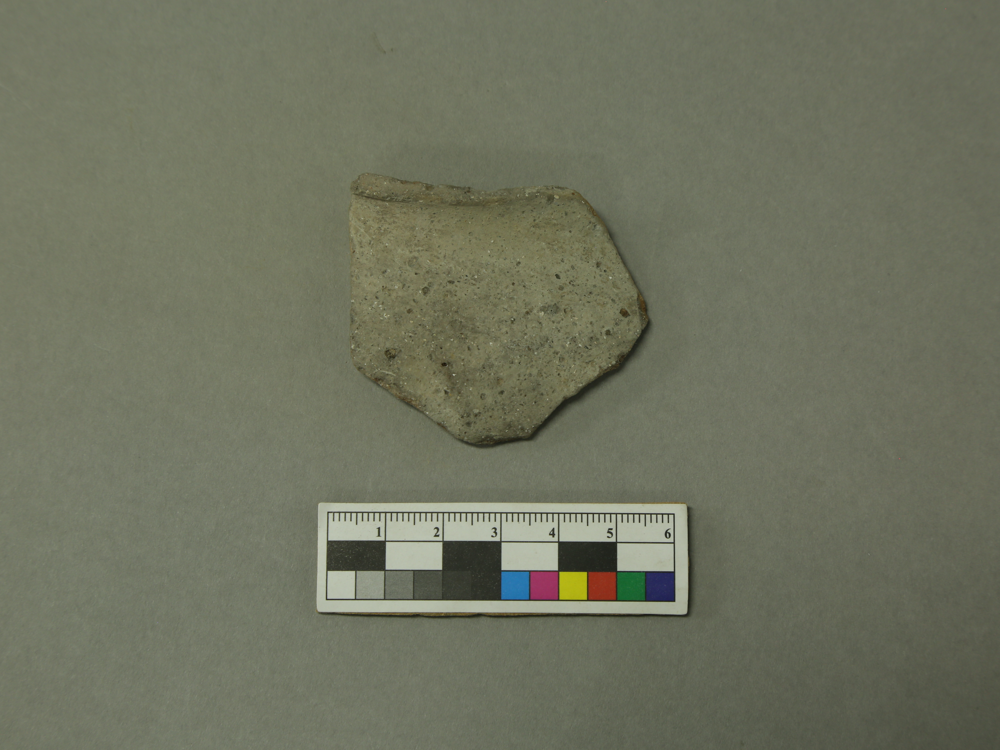

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(cv_img[0])

In [ ]:
cv_img[0].shape

(3840, 5120, 3)

# 3. Unsupervised learning

## 3.1 正反面

In [ ]:
# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle




In [ ]:
import glob
pics = glob.glob(path_pic)

In [ ]:
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features
   


553476096/553467096 [==============================] - 4s 0us/step


In [ ]:
data = {}
p = path_feat + 'pics_features.pkl'
flag = 0
# lop through each image in the dataset
for pic in pics:
    flag += 1
    if flag %100 == 0:
      print ('{} of {} is processing'.format(flag, len(pics)))
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(pic,model)
        data[pic] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          


100 of 1925 is processing
200 of 1925 is processing
300 of 1925 is processing
400 of 1925 is processing
500 of 1925 is processing
600 of 1925 is processing
700 of 1925 is processing
800 of 1925 is processing
900 of 1925 is processing
1000 of 1925 is processing
1100 of 1925 is processing
1200 of 1925 is processing
1300 of 1925 is processing
1400 of 1925 is processing
1500 of 1925 is processing
1600 of 1925 is processing
1700 of 1925 is processing
1800 of 1925 is processing
1900 of 1925 is processing


In [ ]:
p = '/content/gdrive/MyDrive/archeology_AI/Analysis/unsupervised_learning/feat_vgg16/pics_features.pkl'
with open(p,'rb') as file:
  data = pickle.load(file)

In [ ]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

# get the unique labels (from the flower_labels.csv)
# df = pd.read_csv('flower_labels.csv')
# label = df['label'].tolist()
# unique_labels = list(set(label))

unique_labels = desc['照片描述'].unique().tolist()

# reduce the amount of dimensions in the feature vector
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

# cluster feature vectors
kmeans = KMeans(n_clusters=len(unique_labels), random_state=22)
kmeans.fit(x)



KMeans(n_clusters=2, random_state=22)

In [ ]:
filenames.shape

(1925,)

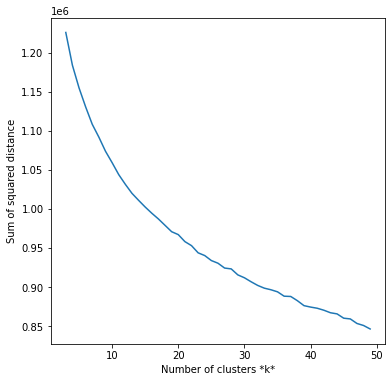

In [ ]:

# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

# function that lets you view a cluster (based on identifier)        
def view_cluster(cluster):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:29]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')
        
   
# this is just incase you want to see which value for k might be the best 
sse = []
list_k = list(range(3, 50))

for k in list_k:
    km = KMeans(n_clusters=k, random_state=22)
    km.fit(x)
    
    sse.append(km.inertia_)

# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(list_k, sse)
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');

In [ ]:
[i[-8:-4] for i in groups[0][:5]]

['0057', '0058', '0059', '0060', '0061']

In [ ]:
[i[-8:-4] for i in groups[1][:5]]

['0069', '0070', '0074', '0468', '0467']

In [ ]:
len(groups[0]), len(groups[1])

(992, 933)

In [ ]:
desc['id'] = desc['照片流水号'].apply(lambda x: x[-4:])
id2plc = {i:j for i,j in zip(desc['id'].tolist(), desc['器物描述'].tolist())}
id2desc = {i:j for i,j in zip(desc['id'].tolist(), desc['照片描述'].tolist())}

In [ ]:
desc.head()

,照片流水号,器物流水号,单位,小件号,器物描述,照片描述,拍摄日期,Unnamed: 7,id
0,8Z1A1336,GS0001,86GSⅢT1415⑤,NaN,口沿,外,2022/5/10下午,可能非小平底,1336
1,8Z1A1337,GS0001,86GSⅢT1415⑤,NaN,口沿,内,NaN,可能非小平底,1337
2,8Z1A1338,GS0002,86GSⅢT1415⑤,NaN,口沿,外,NaN,NaN,1338
3,8Z1A1339,GS0002,86GSⅢT1415⑤,NaN,口沿,内,NaN,NaN,1339
4,8Z1A1340,GS0003,86GSⅢT1415⑤,NaN,口沿,外,NaN,NaN,1340


In [ ]:
np.unique([id2plc[i[-8:-4]] for i in groups[0]], return_counts=True)

(array(['口沿', '底'], dtype='<U2'), array([945,  47]))

In [ ]:
np.unique([id2plc[i[-8:-4]] for i in groups[1]], return_counts=True)

(array(['口沿', '底'], dtype='<U2'), array([716, 217]))

In [ ]:
np.unique([id2desc[i[-8:-4]] for i in groups[0]], return_counts=True)

(array(['内', '外'], dtype='<U1'), array([454, 538]))

In [ ]:
np.unique([id2desc[i[-8:-4]] for i in groups[1]], return_counts=True)

(array(['内', '外'], dtype='<U1'), array([511, 422]))

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(cv_img[0])
cv2.imread(img)

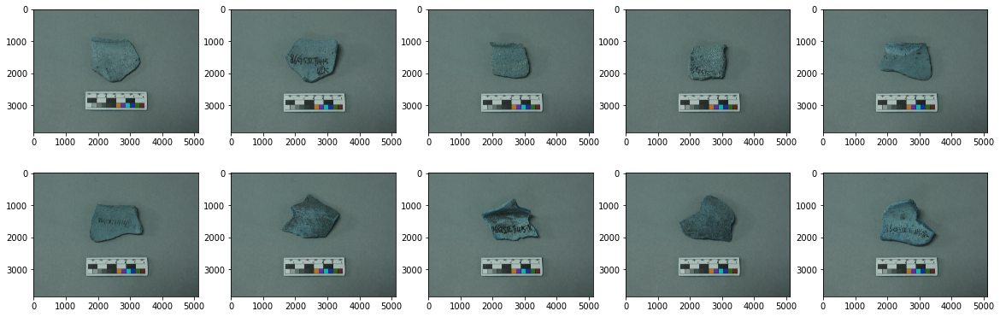

In [ ]:
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import cv2
nImg = 10
columns = 5
images = groups[0][:nImg]
plt.figure(figsize=(20,10))
for i, image in enumerate(images):
    plt.subplot(len(images) / columns + 1, columns, i + 1)
    img = cv2.imread(image)
    plt.imshow(img)

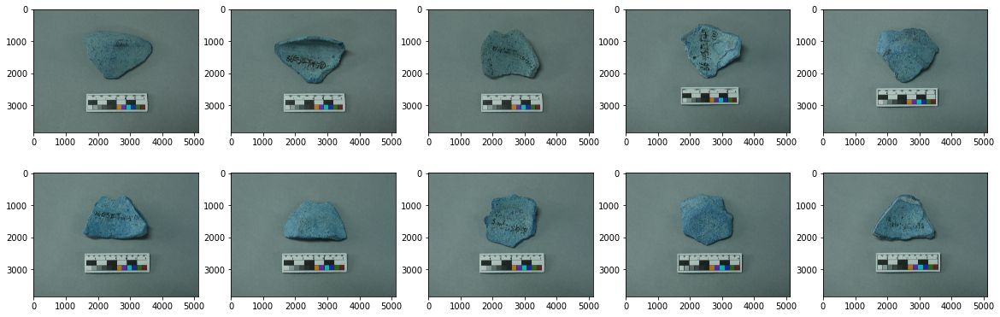

In [ ]:
nImg = 10
columns = 5
images = groups[1][:nImg]
plt.figure(figsize=(20,10))
for i, image in enumerate(images):
    plt.subplot(len(images) / columns + 1, columns, i + 1)
    img = cv2.imread(image)
    plt.imshow(img)

In [ ]:

1. feature extraction works?
2. change network helps?
3. clustering
4. data processing
  - crop out taopian
    segmentation
  - color coding
5. Fine-tune the network using 1000 images, 1000 for 
6. euclidean distance for RGB channel
